# Simulation of CSTR

3 sets of differential equations with some simplifications:

* Constant parameters (C_i, T_ci, T_i)
* No controller for cooling water


Note that Gaussian noise is added after the simulation!

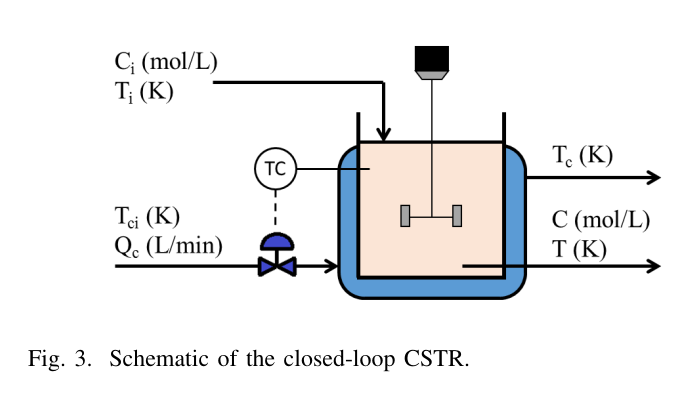

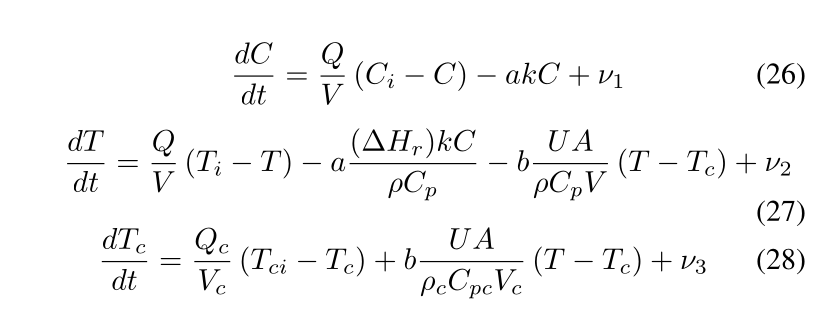



## Recreate Steady Process

We are trying to match the following outputs for the same inputs:

* C = 0.1
* T = 440 K
* T_c = 410 K

In [1]:

# Inputs

V = 150 # L
V_c=10 # L
H_r = -2E5 # cal/mol
UA=7E5 # cal/min/k
k_0=7.2E10 # min^-1
a=1 # -
b=1 # -

n=1 # -
C_p=1 #cal/g/k
rho=1000 # g/L 
rho_c = 1000 # g/L
C_pc=1 # cal/g/K

#
Q_c=150 # L/min
Q=100 # L/min

# Inlet conditions
C_i= 1 # mol/L
T_ci=350 # K
T_i=350; #K 



In [2]:
using DifferentialEquations
using Noise

function cstr_equations!(du,u,p,t)
    
 C_i, T_i, T_ci = p
 E_over_R = 1E4 # K
 k = k_0*exp(−E_over_R/ u[2]) # min^-1

 g1 = Q/V*(C_i-u[1]) - a*k*u[1]^n
    
 du[1] = add_gauss([g1], 0)[1]
 du[2] = Q/V*(T_i-u[2]) - a*H_r*k*u[1]^n/(rho*C_p) - b*UA*(u[2]-u[3])/(rho*C_p*V)
 du[3] = Q_c/V_c*(T_ci - u[3]) + b*UA * (u[2]-u[3])/(rho_c*C_pc*V_c)
end


# Initial conditions...
u0 = [0.98;440.0;410.0]

# Timespan that we are looking 
tspan = (0.0,1200.0)
p = [1, 352, 352]
prob = ODEProblem(cstr_equations!,u0,tspan, p)
sol = solve(prob, QNDF());

In [3]:
# Initial conditions...
u0 = [0.98;440.0;410.0]

# Timespan that we are looking 
tspan = (0.0,1200.0)
p = [1, 352, 352]

3-element Vector{Int64}:
   1
 352
 352

In [4]:
exp(2)

7.38905609893065

In [5]:
2.718^10

22003.639649915618

In [6]:
# Values are 

sol.u[length(sol.u)]

3-element Vector{Float64}:
   0.08743611785408692
 433.6504526129236
 419.24154921064843

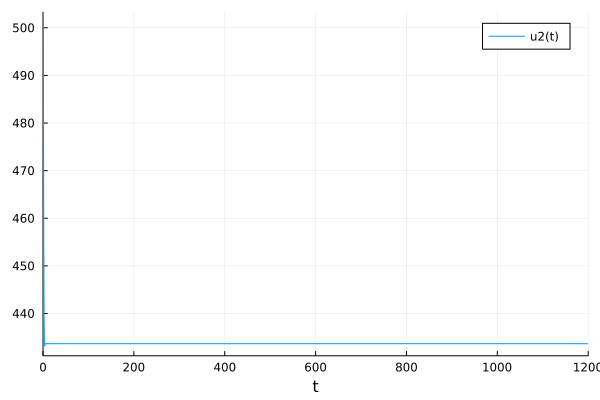

In [7]:
using Plots

plot(sol,vars=(0,2))


### Conclusion

This actually looks very good; values correspond to image below

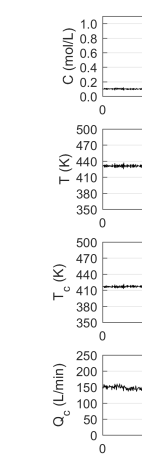

We can also do another check... 

@ t=120

Q_c = 100 L/m
T_ci=347 K


all other input and output variables are the same


In [8]:
Q_c=110 # L/min

# Initial conditions...
u0 = [0.1;440.0;410.0]

# Timespan that we are looking 
tspan = (0.0,1200.0)
p = [0.98, 350, 348]
prob = ODEProblem(cstr_equations!,u0,tspan, p)
sol = solve(prob, QNDF());
sol.u[length(sol.u)]

# Equations seem to be quite sensitive....

3-element Vector{Float64}:
   0.051347221684908746
 444.2416139788158
 431.17176516688187

## Simulating faults

Faults are like this:

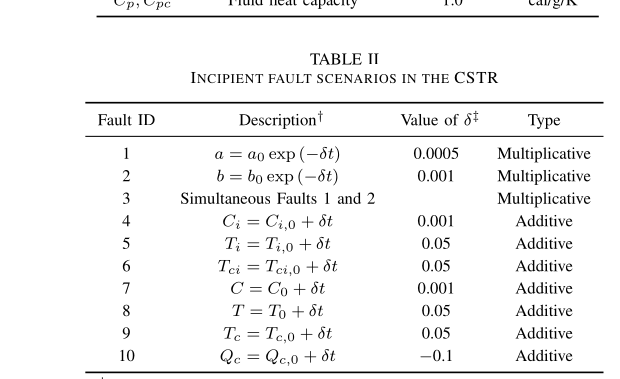

The drop in a likely represents catalyst fouling, while the drop in b is likely to be associated with heat exchanger (HTC) fouling. So these occur within the reaction itself. 

The shift in sensor values I believe should not affect the actual model I think and would only be in the output when doing classificaition (as seems to be suggested by the Simulink model)


All faults should be ok to simulate

We will try to simulate fault 3

In [9]:

# Inputs

V = 150 # L
V_c=10 # L
H_r = -2E5 # cal/mol
UA=7E5 # cal/min/k
k_0=7.2E10 # min^-1
a=1 # -
b=1 # -

n=1 # -
C_p=1 #cal/g/k
rho=1000 # g/L 
rho_c = 1000 # g/L
C_pc=1 # cal/g/K

# I'm not sure what these values should be....
Q_c=150 # L/min
Q=100 # L/min


100

In [10]:
using DifferentialEquations
using Noise

function cstr_equations!(du,u,p,t)
    
 C_i, T_i, T_ci, a,b = p
 E_over_R = 1E4 # K
 k = k_0*exp(−E_over_R/ u[2]) # min^-1

 a_act = a
 b_act=b
 if t>200
     a_act = a*exp(-t*0.0005)
     #b_act = b*exp(-t*0.001)
    end    
 du[1] = Q/V*(C_i-u[1]) - a_act*k*u[1]^n
 du[2] = Q/V*(T_i-u[2]) - a_act*H_r*k*u[1]^n/(rho*C_p) - b_act*UA*(u[2]-u[3])/(rho*C_p*V)
 du[3] = Q_c/V_c*(T_ci - u[3]) + b_act*UA * (u[2]-u[3])/(rho_c*C_pc*V_c)
end


# Initial conditions...
u0 = [0.98;440.0;410.0]

# Timespan that we are looking 
tspan = (0.0,1200.0)
p = [1, 352, 352, 1, 1]
prob = ODEProblem(cstr_equations!,u0,tspan, p, dt=0.0001)
sol = solve(prob, Euler());

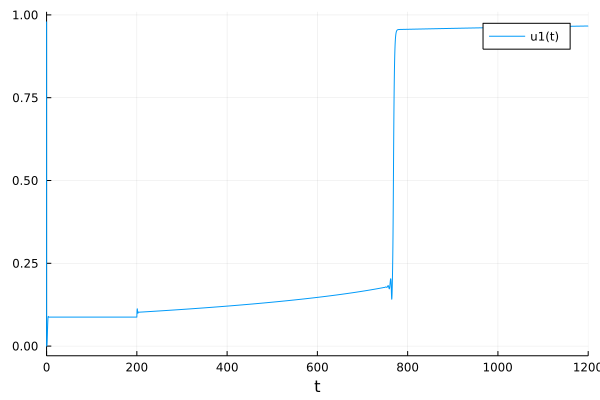

In [11]:
plot(sol,vars=(0,1))


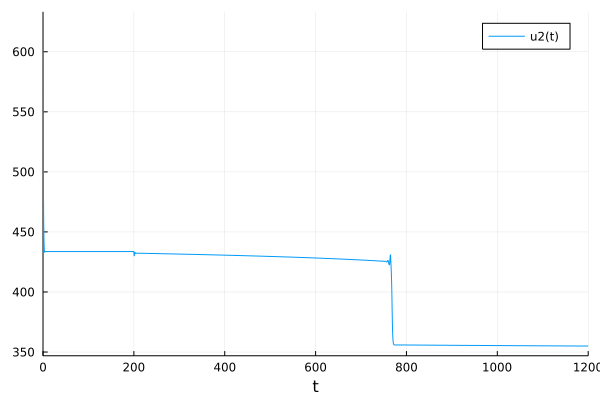

In [12]:
plot(sol,vars=(0,2))


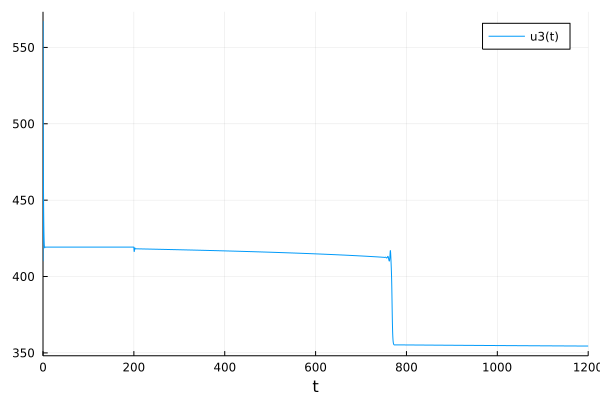

In [13]:
plot(sol,vars=(0,3))


## Conclusions

We can simulate the faults that occur in the system;

Might be interesting to put in various other scenarios

* Start Up phases (low temperature) and shutdown phases (shut off of Q)
* Normal operation but with some variation in inlet conditions (step changes)
* Faulty Normal conditions


We can do a full analysis of this and make sure that it makes sense!




# Bulk simulation of normal and faulty conditions

We need to attach some numbers to this and how this is done;

* Normal simulation (what conditions are varied here?)
* Faulty simulation (seems that there are 10 separate faults; what combinations of these do we select?)

To evaluate the performance robustly, 250 faulty data sets are generated in each fault scenario, differing in
the random seeds for 
* process noise (gaussian term added to the equations)
* measurement noise (gaussian term added to the variable reading)
* input disturbances (step changes the 3 input variables into the functions)

Note that the faults are only introduced after 200 min. 

Just need to setup a system for automatically switching the faults on and off, and varying the appropriate parameters

In [14]:
using DifferentialEquations
using Noise

function cstr_equations!(du,u,p,t)
    
    C = u[1]
    T = u[2]
    T_c = u[3]
    Q_c = u[4]
    C_i = u[5]
    T_i = u[6]
    T_ci = u[7]
    
    a,b, fault_HTC, fault_catalyst = p
    E_over_R = 1E4 # K
    k = k_0*exp(−E_over_R/ T) # min^-1

    a_act = a
    b_act=b

    if (fault_catalyst == 1) && (t>200)
        a_act = a*exp(-t*0.0005)   
    end

    if (fault_HTC == 1) && t>200
        b_act = b*exp(-t*0.001)  
    end
    

        
    du[1] = Q/V*(C_i-C) - a_act*k*C^n +rand(-0.1:0.001:0.1)
    du[2] = Q/V*(T_i-T) - a_act*H_r*k*C^n/(rho*C_p) - b_act*UA*(T-T_c)/(rho*C_p*V)+rand(-5:0.001:5)
    du[3] = Q_c/V_c*(T_ci - T_c) + b_act*UA * (T-T_c)/(rho_c*C_pc*V_c)+rand(-5:0.001:5)
    du[4] = 0
    du[5] = 0
    du[6] = 0
    du[7] = 0
end


# Initial conditions...
u0 = [0.98;440.0;410.0;150; 1; 352; 352]

# Timespan that we are looking 
tspan = (0.0,200.0)
p = [1, 1, 0, 0]
prob = ODEProblem(cstr_equations!,u0,tspan, p, dt=0.0001)
sol = solve(prob, Euler());

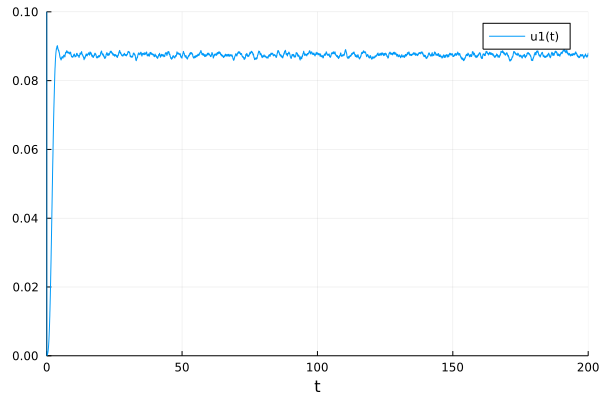

In [15]:
plot(sol,vars=(0,1),ylims=(0,0.1))


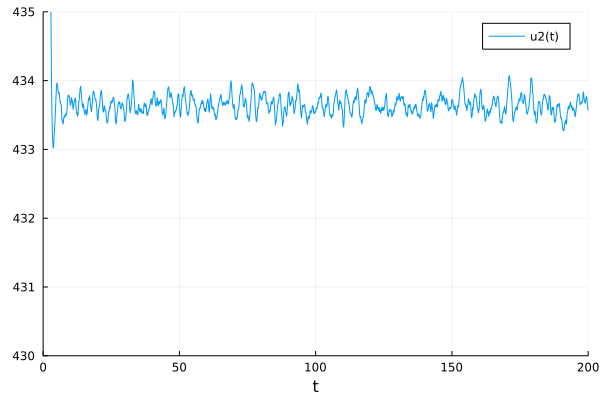

In [16]:
plot(sol,vars=(0,2), ylim=(430,435))


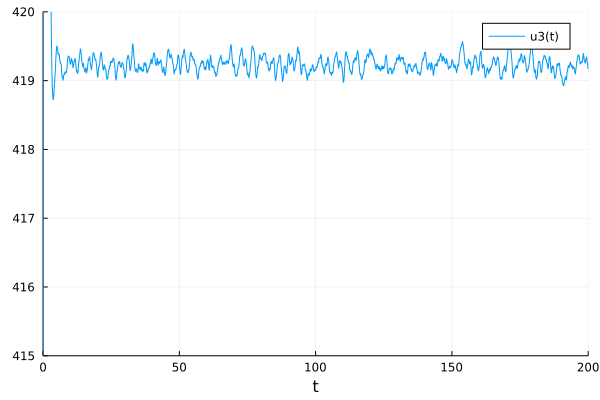

In [17]:
plot(sol,vars=(0,3), ylim=(415,420))


In [18]:
rand(0:0.001:0.05)

0.0

In [19]:
fault_dict = Dict([(1, [1,0]), (2, [0,1]), (3, [1,1])])

Dict{Int64, Vector{Int64}} with 3 entries:
  2 => [0, 1]
  3 => [1, 1]
  1 => [1, 0]

In [20]:
offsets = Dict([(4, [0,0,0,0,1,0,0]), 
        (5, [0,0,0,0,0,1,0]), 
        (6, [0,0,0,0,0,0,1]), 
        (7, [1,0,0,0,0,0,0]), 
        (8, [0,1,0,0,0,0,0]), 
        (9, [0,0,1,0,0,0,0]), 
        (10, [0,0,0,1,0,0,0])])

Dict{Int64, Vector{Int64}} with 7 entries:
  5  => [0, 0, 0, 0, 0, 1, 0]
  4  => [0, 0, 0, 0, 1, 0, 0]
  6  => [0, 0, 0, 0, 0, 0, 1]
  7  => [1, 0, 0, 0, 0, 0, 0]
  10 => [0, 0, 0, 1, 0, 0, 0]
  9  => [0, 0, 1, 0, 0, 0, 0]
  8  => [0, 1, 0, 0, 0, 0, 0]

In [21]:
N_SIM = 1
N_FAULT = 1



# Doing a certain number of sims per use case
store = []
for n_sim=1:N_SIM
    print(n_sim)
    
    # For each fault
    for n_fault=1:N_FAULT
        
        # Default params
        params = [0,0]
        
        # Get the relevant parameters
        if n_fault in [1,2,3]
            params = fault_dict[n_fault]
            #print(params)
        end
        
        # Adjust parameter inputs
        p = [1, 1, params[1], params[2]]
        
        # Implement changes to inlet conditions
        # C_i, T_i, T_ci
        
        # Solve!
        u0 = [0.98;440.0;410.0;150; 1; 352; 352]
        tspan = (0.0,1000.0)
        prob = ODEProblem(cstr_equations!,u0,tspan, p, dt=0.1)
        sol = solve(prob, RK4());
        
        # Format the results and add Gaussian measurement noise
        C = add_gauss([sol.u[item][1] for item=1:1:length(sol.u)],0.01)
        T = add_gauss([sol.u[item][2] for item=1:1:length(sol.u)],0.5)
        T_c = add_gauss([sol.u[item][3] for item=1:1:length(sol.u)],0.5)
        Q_c = add_gauss([sol.u[item][4] for item=1:1:length(sol.u)],2)
        t = [sol.t[item] for item=1:1:length(sol.u)]
        
        # If additive fault, then add relevant shifts
        if n_fault in [4,5,6,7,8,9,10]
           offset =  offsets[n_fault]
           C_off, T_off, T_c_off, Q_c_off, C_i_off, T_i_off, T_ci_off = offset
            
           C = C.+ C_off
           T = T.+T_off
           T_c = T_c.+T_c_off
           Q_c = Q_c.+Q_c_off
           C_i = C_i.+C_i_off
           T_i = T_i.+T_i_off
           T_ci = T_ci.+T_ci_off
            
        end
        

        # Add to storage array
        append!(store,[t, C, T, T_c, Q_c, C_i, T_i, T_ci])
        
    end
end
        


1

┌ Warning: Interrupted. Larger maxiters is needed.
└ @ SciMLBase /home/keepfloyding/.julia/packages/SciMLBase/mndcy/src/integrator_interface.jl:331


In [22]:
plot(store[1], store[2])

In [23]:
store[1]

999876-element Vector{Float64}:
   0.0
   0.004
   0.006058681532572023
   0.008372913636644825
   0.010460596797715755
   0.011776275540906411
   0.012608529567015681
   0.013170417701313022
   0.013589564566360755
   0.013831551730156868
   0.013994016879045681
   0.0141301126097833
   0.014222408743399795
   ⋮
 323.7015232562772
 323.70182682693905
 323.7021473279973
 323.70254245476036
 323.70288461585073
 323.703190270881
 323.7034906248522
 323.70382350104325
 323.70415142413543
 323.70446967534235
 323.70480136752684
 323.70512674251466

# Conclusion

Almost but not quite; there are still some issues left to resolve

* How do we handle time varying parameters (investigate this idea of call backs with different parameters) -> try this out
* Depending on what method we choose, we would need to resample to have 1 min granularity
* The whole code base is kinda dirty... need to clean it up a little bit
* Need to sanity check if we are using the right ODE solver...

Then afterwards, it is not clear what we will do with the simulations; I see it as options:
* Sample classification (it feels kinda unhelpful) but can be interesting in testing transfer learning procedures
* Control charts (monitoring each data point as it goes along)

Can the former somehow incorporate transfer learning? To me, that is still unclear...